In [1]:
import os
from glob import glob
import numpy as np
import dask
import xarray as xr
import cartopy.crs as ccrs
from cmocean import cm
import xgcm

from matplotlib import pyplot as plt
%matplotlib inline
plt.rcParams['figure.figsize'] = 20, 12

from mitequinox.utils import *
from dask import compute, delayed

/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.6/site-packages/cmocean/tools.py:76: MatplotlibDeprecationWarning: The is_string_like function was deprecated in version 2.1.
  if not mpl.cbook.is_string_like(rgbin[0]):
/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.6/importlib/_bootstrap.py:219: RuntimeWarning: numpy.dtype size changed, may indicate binary incompatibility. Expected 96, got 88
  return f(*args, **kwds)
/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.6/importlib/_bootstrap.py:219: RuntimeWarning: numpy.dtype size changed, may indicate binary incompatibility. Expected 96, got 88
  return f(*args, **kwds)


In [2]:
from dask_jobqueue import PBSCluster
local_dir = os.getenv('TMPDIR')
cluster = PBSCluster(local_directory=local_dir)
#print(cluster.job_script())
w = cluster.start_workers(30)

/home1/datahome/xyu/.miniconda3/envs/equinox/lib/python3.6/site-packages/distributed/utils.py:128: RuntimeWarning: Couldn't detect a suitable IP address for reaching '8.8.8.8', defaulting to '127.0.0.1': [Errno 101] Network is unreachable
  % (host, default, e), RuntimeWarning)


In [3]:
# get dask handles and check dask server status
from dask.distributed import Client
client = Client(cluster)

In [4]:
client

Client Scheduler: tcp://10.148.1.0:43468 Dashboard: http://10.148.1.0:8787/status,Cluster Workers: 42 Cores: 168 Memory: 2100.00 GB


_________
# Read dataset


In [5]:
data_dir = '/home1/scratch/xyu/mit_zarr/'
face_all = 13

D = [xr.open_zarr(data_dir+'UV/SSU_rotation_f%02d.zarr'%(face)) for face in range(face_all)]
ds_SSU = xr.concat(D, dim='face')

D = [xr.open_zarr(data_dir+'UV/SSV_rotation_f%02d.zarr'%(face)) for face in range(face_all)]
ds_SSV = xr.concat(D, dim='face')

D = [xr.open_zarr(data_dir+'Eta_f%02d.zarr'%(face)) for face in range(face_all)]
ds_Eta = xr.concat(D, dim='face')

grid = xr.open_dataset('/home1/scratch/xyu/grid/mit_grid.nc', decode_coords=True)
#grid = xr.open_zarr('/home1/scratch/xyu/mit_grid.zarr')

In [6]:
%time ds = xr.merge([ds_Eta, ds_SSU, ds_SSV, grid])
print(ds)
print('\n data size: %.1f GB' %(ds.nbytes / 1e9))

CPU times: user 8 ms, sys: 0 ns, total: 8 ms
Wall time: 5.62 ms
<xarray.Dataset>
Dimensions:       (face: 13, i: 4320, i_g: 4320, j: 4320, j_g: 4320, time: 1440)
Coordinates:
  * face          (face) int64 0 1 2 3 4 5 6 7 8 9 10 11 12
    dtime         (time) datetime64[ns] 2011-11-15 2011-11-15T01:00:00 ...
  * i             (i) int64 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 ...
  * j             (j) int64 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 ...
  * time          (time) float64 5.702e+06 5.706e+06 5.71e+06 5.713e+06 ...
  * i_g           (i_g) int64 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 ...
  * j_g           (j_g) int64 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 ...
    XC            (face, j, i) float32 ...
    YC            (face, j, i) float32 ...
    XG            (face, j_g, i_g) float32 ...
    YG            (face, j_g, i_g) float32 ...
    CS            (face, j, i) float32 ...
    SN            (face, j, i) float32 ...
    rA            (face, j, 

In [5]:
E_dir = '/home1/scratch/xyu/momentum/'

---


# 1. Time derivative of SSU ($G_u$)

A central difference is applied to compute du/dt.

In [8]:
for face in range(ds['face'].size):
    
    d_SSU_dt_time = ( ds['SSU_rotation'].isel(face=face).shift(time=-1) - ds['SSU_rotation'].isel(face=face).shift(time=1) )/2/3600
    d_SSU_dt_time = d_SSU_dt_time.rename('d_SSU_dt_time')
    d_SSU_dt_time = d_SSU_dt_time.chunk({'time': 1,'i_g':4320,'j':4320})
    
    d_SSU_dt_time.to_dataset().to_zarr(E_dir+'d_SSU_dt_f%02d.zarr'% (face), mode='w')
    print('face=%d - allready processed'%(face))

face=0 - allready processed
face=1 - allready processed
face=2 - allready processed
face=3 - allready processed
face=4 - allready processed
face=5 - allready processed
face=6 - allready processed
face=7 - allready processed
face=8 - allready processed
face=9 - allready processed
face=10 - allready processed
face=11 - allready processed
face=12 - allready processed


In [ ]:
for face in range(ds['face'].size):
    
    d_SSV_dt_time = ( ds['SSV_rotation'].isel(face=face).shift(time=-1) - ds['SSV_rotation'].isel(face=face).shift(time=1) )/2/3600
    d_SSV_dt_time = d_SSV_dt_time.rename('d_SSV_dt_time')
    d_SSV_dt_time = d_SSV_dt_time.chunk({'time': 1,'i':4320,'j_g':4320})
    
    d_SSV_dt_time.to_dataset().to_zarr(E_dir+'d_SSV_dt_f%02d.zarr'% (face), mode='w')
    print('face=%d - allready processed'%(face))

face=0 - allready processed
face=1 - allready processed
face=2 - allready processed
face=3 - allready processed
face=4 - allready processed
face=5 - allready processed
face=6 - allready processed
face=7 - allready processed
face=8 - allready processed
face=9 - allready processed
face=10 - allready processed


_______

# 2. Coriolis terms ($G_u^{fv}$ and $G_v^{fu}$)

Next we create a `Grid` object from the dataset.
We need to tell xgcm that the `X` and `Y` axes are periodic.
(The other axes will be assumed to be non-periodic.)

In [10]:
grid = xgcm.Grid(ds, periodic=['X', 'Y'])
grid

<xgcm.Grid>
X Axis (periodic):
  * center   i (4320) --> left
  * left     i_g (4320) --> center
Y Axis (periodic):
  * center   j (4320) --> left
  * left     j_g (4320) --> center

In [11]:
lat = ds['YG']
omega = 7.3/100000
f = 2*omega*np.sin(np.deg2rad(lat))
f_i = grid.interp(f,'X')
f_j = grid.interp(f,'Y')

In [28]:
for face in range(ds['face'].size):

    dxgSSV_j = grid.interp(ds.dxG.isel(face=face) * ds['SSV_rotation'].isel(face=face),'Y') 
    dxgSSV_ji = grid.interp(dxgSSV_j,'X')    # SSV at (i_g,j)
    zeta_3 = (grid.diff(ds.dyC.isel(face=face) * ds['SSV_rotation'].isel(face=face),'X') - grid.diff(ds.dxC.isel(face=face) * ds['SSU_rotation'].isel(face=face),'Y'))/ds.rAz.isel(face=face) # relative vorticity  
    Coriolis_u = (f_j.isel(face=face) + grid.interp(zeta_3,'Y')) * dxgSSV_ji /ds.dxC.isel(face=face)    #(f+zeta)*SSV
    Coriolis_u = np.real(Coriolis_u).rename('Coriolis_u')
    Coriolis_u = Coriolis_u.chunk({'time': 1,'i_g':4320,'j':4320})
    Coriolis_u.to_dataset().to_zarr(E_dir+'Coriolis_u_f%02d.zarr'% (face), mode='w')
    print('face=%d - allready processed'%(face))

face=0 - allready processed
face=1 - allready processed
face=2 - allready processed
face=3 - allready processed
face=4 - allready processed
face=5 - allready processed
face=6 - allready processed
face=7 - allready processed
face=8 - allready processed
face=9 - allready processed
face=10 - allready processed
face=11 - allready processed
face=12 - allready processed


In [15]:
for face in range(ds['face'].size):

    dygSSU_i = grid.interp(ds.dyG.isel(face=face) * ds['SSU_rotation'].isel(face=face),'X') 
    dxgSSU_ij = grid.interp(dygSSU_i,'Y')    # SSU at (i,j_g)
    zeta_3 = (grid.diff(ds.dyC.isel(face=face) * ds['SSV_rotation'].isel(face=face),'X') - grid.diff(ds.dxC.isel(face=face) * ds['SSU_rotation'].isel(face=face),'Y'))/ds.rAz.isel(face=face) # relative vorticity  
    Coriolis_v = -(f_i.isel(face=face) + grid.interp(zeta_3,'X')) * dxgSSU_ij /ds.dyC.isel(face=face)    #-(f+zeta)*SSU
    Coriolis_v = np.real(Coriolis_v).rename('Coriolis_v')
    Coriolis_v = Coriolis_v.chunk({'time': 1,'i':4320,'j_g':4320})
    Coriolis_v.to_dataset().to_zarr(E_dir+'Coriolis_v_f%02d.zarr'% (face), mode='w')
    print('face=%d - allready processed'%(face))

face=0 - allready processed
face=1 - allready processed
face=2 - allready processed
face=3 - allready processed
face=4 - allready processed
face=5 - allready processed


distributed.utils_perf - WARNING - full garbage collections took 10% CPU time recently (threshold: 10%)


face=6 - allready processed
face=7 - allready processed
face=8 - allready processed
face=9 - allready processed
face=10 - allready processed


distributed.utils_perf - WARNING - full garbage collections took 10% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 10% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 10% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 10% CPU time recently (threshold: 10%)


face=11 - allready processed


distributed.utils_perf - WARNING - full garbage collections took 10% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 10% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 10% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 10% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 10% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 10% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 10% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 10% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 10% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took

face=12 - allready processed


# 3. Gradient of Bernoulli function

In [31]:
# about 1.5 hours

for face in range(ds['face'].size):

    g = 9.81
    
    KE = (grid.interp(ds['SSU_rotation'].isel(face=face)**2,'X') + grid.interp(ds['SSV_rotation'].isel(face=face)**2,'Y'))/2 # KE
    
    dB_dx_raw = (grid.diff(g*ds['Eta'].isel(face=face),'X') + grid.diff(KE,'X'))/ds.dxC.isel(face=face)     # d(Eta*g + KE)/dx
    dB_dy_raw = (grid.diff(g*ds['Eta'].isel(face=face),'Y') + grid.diff(KE,'Y'))/ds.dyC.isel(face=face)     # d(Eta*g + KE)/dy

    # rotation
    dB_dx_raw_ij = grid.interp(dB_dx_raw,'X')
    dB_dy_raw_ij = grid.interp(dB_dy_raw,'Y')
    
    dB_dx_raw_rotation =  dB_dx_raw_ij*ds.CS.isel(face=face) - dB_dy_raw_ij*ds.SN.isel(face=face)
    dB_dy_raw_rotation =  dB_dx_raw_ij*ds.SN.isel(face=face) + dB_dy_raw_ij*ds.CS.isel(face=face)

    dB_dx = grid.interp(dB_dx_raw_rotation,'X')
    dB_dy = grid.interp(dB_dy_raw_rotation,'Y')
    
    # store
    dB_dx = np.real(dB_dx).rename('dB_dx')    
    dB_dx = dB_dx.chunk({'time': 1,'i_g':4320,'j':4320})
    dB_dx.to_dataset().to_zarr(E_dir+'dB_dx_f%02d.zarr'% (face), mode='w')
    
    dB_dy = np.real(dB_dy).rename('dB_dy')    
    dB_dy = dB_dy.chunk({'time': 1,'i':4320,'j_g':4320})
    dB_dy.to_dataset().to_zarr(E_dir+'dB_dy_f%02d.zarr'% (face), mode='w')        
    
    print('face=%d - allready processed'%(face))

distributed.utils_perf - WARNING - full garbage collections took 10% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 10% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 10% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 10% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 10% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 10% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 10% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 10% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 10% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took

face=0 - allready processed


distributed.utils_perf - WARNING - full garbage collections took 11% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 11% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 11% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 11% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 11% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 11% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 11% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 11% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 11% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took

face=1 - allready processed


distributed.utils_perf - WARNING - full garbage collections took 10% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 10% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 10% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 10% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 10% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 10% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 10% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 10% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 10% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took

face=2 - allready processed


distributed.utils_perf - WARNING - full garbage collections took 10% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 10% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 10% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 10% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 10% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 10% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 10% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 10% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 10% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took

face=3 - allready processed


distributed.utils_perf - WARNING - full garbage collections took 12% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 12% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 12% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 12% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 12% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 12% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 12% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 12% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 12% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took

face=4 - allready processed


distributed.utils_perf - WARNING - full garbage collections took 11% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 11% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 11% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 11% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 11% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 11% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 11% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 11% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 11% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took

face=5 - allready processed


distributed.utils_perf - WARNING - full garbage collections took 11% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 11% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 11% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 11% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 11% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 11% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 11% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 11% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 11% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took

face=6 - allready processed


distributed.utils_perf - WARNING - full garbage collections took 11% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 11% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 11% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 11% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 11% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 11% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 11% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 11% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 11% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took

face=7 - allready processed


distributed.utils_perf - WARNING - full garbage collections took 10% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 10% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 10% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 10% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 10% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 10% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 10% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 10% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 10% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took

face=8 - allready processed


distributed.utils_perf - WARNING - full garbage collections took 12% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 12% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 12% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 12% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 12% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 12% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 12% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 12% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 12% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took

face=9 - allready processed


distributed.utils_perf - WARNING - full garbage collections took 12% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 12% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 12% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 12% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 12% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 12% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 12% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 12% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 12% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took

face=10 - allready processed


distributed.utils_perf - WARNING - full garbage collections took 13% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 13% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 13% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 13% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 13% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 13% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 13% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 13% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 13% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took

face=11 - allready processed


distributed.utils_perf - WARNING - full garbage collections took 14% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 14% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 14% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 14% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 14% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 14% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 14% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 14% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took 14% CPU time recently (threshold: 10%)
distributed.utils_perf - WARNING - full garbage collections took

face=12 - allready processed


# 4. Residuals

In [ ]:
D = [xr.open_zarr(E_dir+'d_SSU_dt_f%02d.zarr'%(face)) for face in range(13)]
ds_tmp = xr.concat(D, dim='face')

D = [xr.open_zarr(E_dir+'Coriolis_u_f%02d.zarr'%(face)) for face in range(13)]
ds_Coriolis = xr.concat(D, dim='face')

D = [xr.open_zarr(E_dir+'dB_dx_f%02d.zarr'%(face)) for face in range(13)]
ds_B = xr.concat(D, dim='face')

%time ds = xr.merge([ds_tmp,ds_Coriolis,ds_B])
print(ds)
print('\n data size: %.1f GB' %(ds.nbytes / 1e9))

In [43]:
for face in range(ds['face'].size):

    residuals_u = ds['d_SSU_dt_time'] - ds['Coriolis_u'] + ds['dB_dx']
    residuals_u = np.real(residuals_u).rename('residuals_u').sel(face=face)  
    residuals_u = residuals_u.chunk({'time': 1,'i_g':4320,'j':4320})
    residuals_u.to_dataset().to_zarr(E_dir+'residuals_u_f%02d.zarr'% (face), mode='w')
    print('face=%d - allready processed'%(face))

face=0 - allready processed
face=1 - allready processed
face=2 - allready processed
face=3 - allready processed
face=4 - allready processed
face=5 - allready processed
face=6 - allready processed
face=7 - allready processed
face=8 - allready processed
face=9 - allready processed
face=10 - allready processed
face=11 - allready processed
face=12 - allready processed


In [6]:
D = [xr.open_zarr(E_dir+'d_SSV_dt_f%02d.zarr'%(face)) for face in range(13)]
ds_tmp = xr.concat(D, dim='face')

D = [xr.open_zarr(E_dir+'Coriolis_v_f%02d.zarr'%(face)) for face in range(13)]
ds_Coriolis = xr.concat(D, dim='face')

D = [xr.open_zarr(E_dir+'dB_dy_f%02d.zarr'%(face)) for face in range(13)]
ds_B = xr.concat(D, dim='face')

%time ds = xr.merge([ds_tmp,ds_Coriolis,ds_B])
print(ds)
print('\n data size: %.1f GB' %(ds.nbytes / 1e9))

CPU times: user 1.32 s, sys: 572 ms, total: 1.89 s
Wall time: 9.6 s
<xarray.Dataset>
Dimensions:        (face: 13, i: 4320, j_g: 4320, time: 1440)
Coordinates:
  * face           (face) int64 0 1 2 3 4 5 6 7 8 9 10 11 12
    dtime          (time) datetime64[ns] 2011-11-15 2011-11-15T01:00:00 ...
  * i              (i) int64 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 ...
  * j_g            (j_g) int64 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 ...
  * time           (time) float64 5.702e+06 5.706e+06 5.71e+06 5.713e+06 ...
    dxG            (face, j_g, i) float32 dask.array<shape=(13, 4320, 4320), chunksize=(1, 4320, 4320)>
    dyC            (face, j_g, i) float32 dask.array<shape=(13, 4320, 4320), chunksize=(1, 4320, 4320)>
    rAs            (face, j_g, i) float32 dask.array<shape=(13, 4320, 4320), chunksize=(1, 4320, 4320)>
Data variables:
    d_SSV_dt_time  (face, time, j_g, i) float32 dask.array<shape=(13, 1440, 4320, 4320), chunksize=(1, 1, 4320, 4320)>
    Coriolis_v     (

In [8]:
face_all = [6,7,8,9,10,11,12]

In [9]:
#for face in range(ds['face'].size):
for face in face_all:

    residuals_v = ds['d_SSV_dt_time'] - ds['Coriolis_v'] + ds['dB_dy']
    residuals_v = np.real(residuals_v).rename('residuals_v').sel(face=face)  
    residuals_v = residuals_v.chunk({'time': 1,'i':4320,'j_g':4320})
    residuals_v.to_dataset().to_zarr(E_dir+'residuals_v_f%02d.zarr'% (face), mode='w')
    print('face=%d - allready processed'%(face))

RuntimeError: error during blosc decompression: -1

# 5. Figures

In [8]:
D = [xr.open_zarr(E_dir+'d_SSU_dt_f%02d.zarr'%(face)) for face in range(13)]
ds_tmp = xr.concat(D, dim='face')

D = [xr.open_zarr(E_dir+'Coriolis_u_f%02d.zarr'%(face)) for face in range(13)]
ds_Coriolis = xr.concat(D, dim='face')

D = [xr.open_zarr(E_dir+'dB_dx_f%02d.zarr'%(face)) for face in range(13)]
ds_B = xr.concat(D, dim='face')

D = [xr.open_zarr(E_dir+'residuals_u_f%02d.zarr'%(face)) for face in range(13)]
ds_residuals = xr.concat(D, dim='face')

%time ds = xr.merge([ds_tmp,ds_Coriolis,ds_B,ds_residuals])
print(ds)
print('\n data size: %.1f GB' %(ds.nbytes / 1e9))

CPU times: user 3.5 s, sys: 1.32 s, total: 4.81 s
Wall time: 8.17 s
<xarray.Dataset>
Dimensions:        (face: 13, i_g: 4320, j: 4320, time: 720)
Coordinates:
  * face           (face) int64 0 1 2 3 4 5 6 7 8 9 10 11 12
    dtime          (time) datetime64[ns] 2011-11-15 2011-11-15T01:00:00 ...
  * i_g            (i_g) int64 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 ...
  * j              (j) int64 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 ...
  * time           (time) float64 5.702e+06 5.706e+06 5.71e+06 5.713e+06 ...
    dxC            (face, j, i_g) float32 dask.array<shape=(13, 4320, 4320), chunksize=(1, 4320, 4320)>
    dyG            (face, j, i_g) float32 dask.array<shape=(13, 4320, 4320), chunksize=(1, 4320, 4320)>
    rAw            (face, j, i_g) float32 dask.array<shape=(13, 4320, 4320), chunksize=(1, 4320, 4320)>
Data variables:
    d_SSU_dt_time  (face, time, j, i_g) float32 dask.array<shape=(13, 720, 4320, 4320), chunksize=(1, 1, 4320, 4320)>
    Coriolis_u     (fa

In [35]:
D = [xr.open_zarr(E_dir+'d_SSV_dt_f%02d.zarr'%(face)) for face in range(13)]
ds_tmp = xr.concat(D, dim='face')

D = [xr.open_zarr(E_dir+'Coriolis_v_f%02d.zarr'%(face)) for face in range(13)]
ds_Coriolis = xr.concat(D, dim='face')

D = [xr.open_zarr(E_dir+'dB_dy_f%02d.zarr'%(face)) for face in range(13)]
ds_B = xr.concat(D, dim='face')

D = [xr.open_zarr(E_dir+'residuals_v_f%02d.zarr'%(face)) for face in range(13)]
ds_residuals = xr.concat(D, dim='face')

%time ds = xr.merge([ds_tmp,ds_Coriolis,ds_B,ds_residuals])
print(ds)
print('\n data size: %.1f GB' %(ds.nbytes / 1e9))

CPU times: user 3.46 s, sys: 1.32 s, total: 4.78 s
Wall time: 7.33 s
<xarray.Dataset>
Dimensions:        (face: 13, i: 4320, j_g: 4320, time: 720)
Coordinates:
  * face           (face) int64 0 1 2 3 4 5 6 7 8 9 10 11 12
    dtime          (time) datetime64[ns] 2011-11-15 2011-11-15T01:00:00 ...
  * i              (i) int64 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 ...
  * j_g            (j_g) int64 0 1 2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 ...
  * time           (time) float64 5.702e+06 5.706e+06 5.71e+06 5.713e+06 ...
    dxG            (face, j_g, i) float32 dask.array<shape=(13, 4320, 4320), chunksize=(1, 4320, 4320)>
    dyC            (face, j_g, i) float32 dask.array<shape=(13, 4320, 4320), chunksize=(1, 4320, 4320)>
    rAs            (face, j_g, i) float32 dask.array<shape=(13, 4320, 4320), chunksize=(1, 4320, 4320)>
Data variables:
    d_SSV_dt_time  (face, time, j_g, i) float32 dask.array<shape=(13, 720, 4320, 4320), chunksize=(1, 1, 4320, 4320)>
    Coriolis_v     (f

## zonal

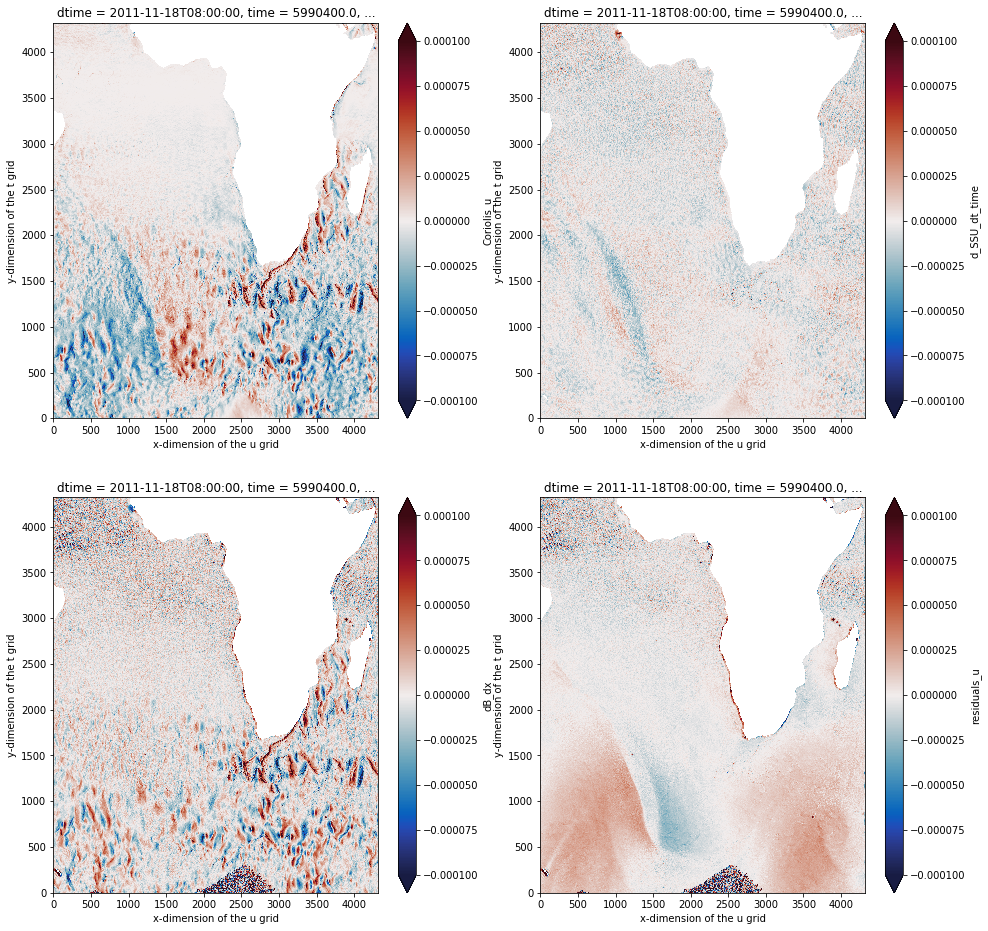

In [55]:
face_plot = 1

fig = plt.figure(figsize = (16,16))

plt.subplot(221)
ds['Coriolis_u'].isel(face= face_plot,time=80).plot(vmin=-0.0001, vmax=0.0001, cmap = cm.balance)
plt.subplot(222)
ds['d_SSU_dt_time'].isel(face= face_plot,time=80).plot(vmin=-0.0001, vmax=0.0001, cmap = cm.balance)
plt.subplot(223)
ds['dB_dx'].isel(face= face_plot,time=80).plot(vmin=-0.0001, vmax=0.0001, cmap = cm.balance)
plt.subplot(224)
ds['residuals_u'].isel(face= face_plot,time=80).plot(vmin=-0.0001, vmax=0.0001, cmap = cm.balance)

## meridional

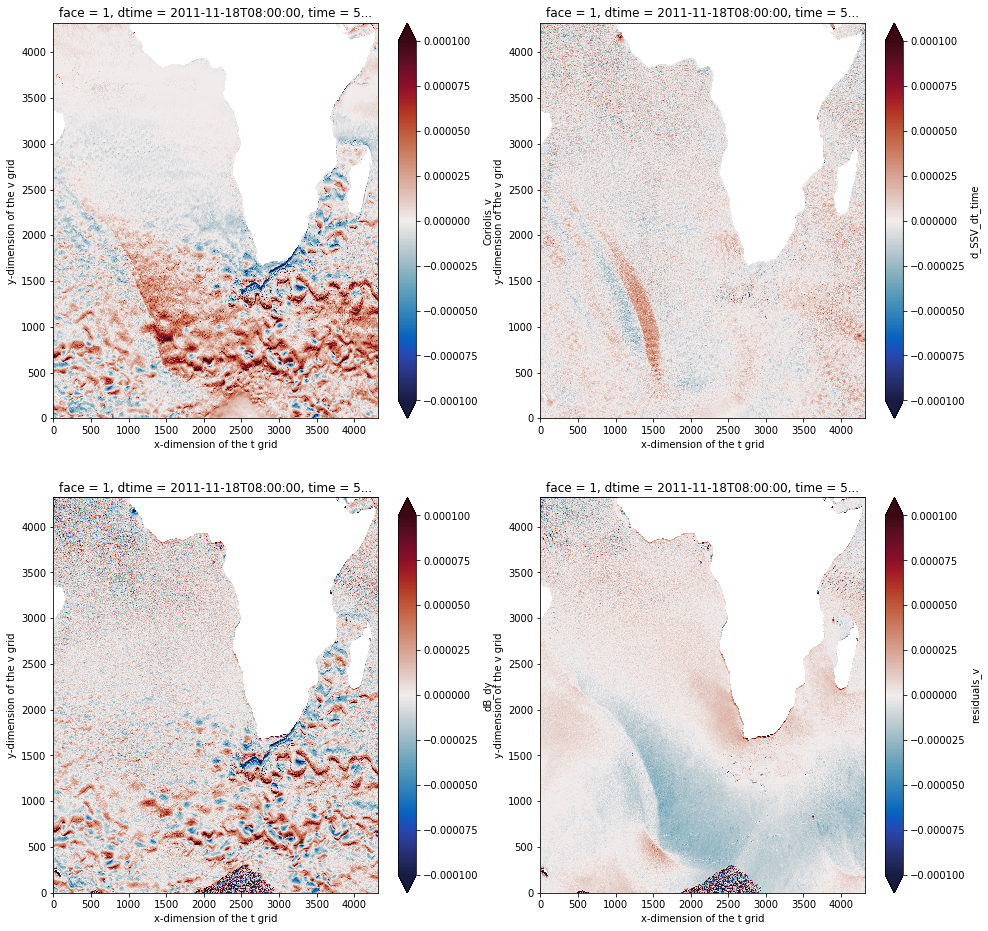

In [36]:
face_plot = 1

fig = plt.figure(figsize = (16,16))

plt.subplot(221)
ds['Coriolis_v'].isel(face= face_plot,time=80).plot(vmin=-0.0001, vmax=0.0001, cmap = cm.balance)
plt.subplot(222)
ds['d_SSV_dt_time'].isel(face= face_plot,time=80).plot(vmin=-0.0001, vmax=0.0001, cmap = cm.balance)
plt.subplot(223)
ds['dB_dy'].isel(face= face_plot,time=80).plot(vmin=-0.0001, vmax=0.0001, cmap = cm.balance)
plt.subplot(224)
ds['residuals_v'].isel(face= face_plot,time=80).plot(vmin=-0.0001, vmax=0.0001, cmap = cm.balance)

## Global 

In [37]:
def quick_llc_plot(data, axis_off=False, **kwargs):
    face_to_axis = {0: (2, 0), 1: (1, 0), 2: (0, 0),
                    3: (2, 1), 4: (1, 1), 5: (0, 1),
                    7: (0, 2), 8: (1, 2), 9: (2, 2),
                    10: (0, 3), 11: (1, 3), 12: (2, 3)}
    transpose = [7, 8, 9, 10, 11, 12]
    gridspec_kw = dict(left=0, bottom=0, right=4, top=4, wspace=0, hspace=0)
    fig, axes = plt.subplots(nrows=3, ncols=4, gridspec_kw=gridspec_kw)
    for face, (j, i) in face_to_axis.items():
        data_ax = data.isel(face=face)
        ax = axes[j,i]
        yincrease = True
        if face in transpose:
            data_ax = data_ax.transpose()
            yincrease = False
        data_ax.plot(ax=ax, yincrease=yincrease, **kwargs)
        if axis_off:
            ax.axis('off')
        ax.set_title('')

### zonal momentum

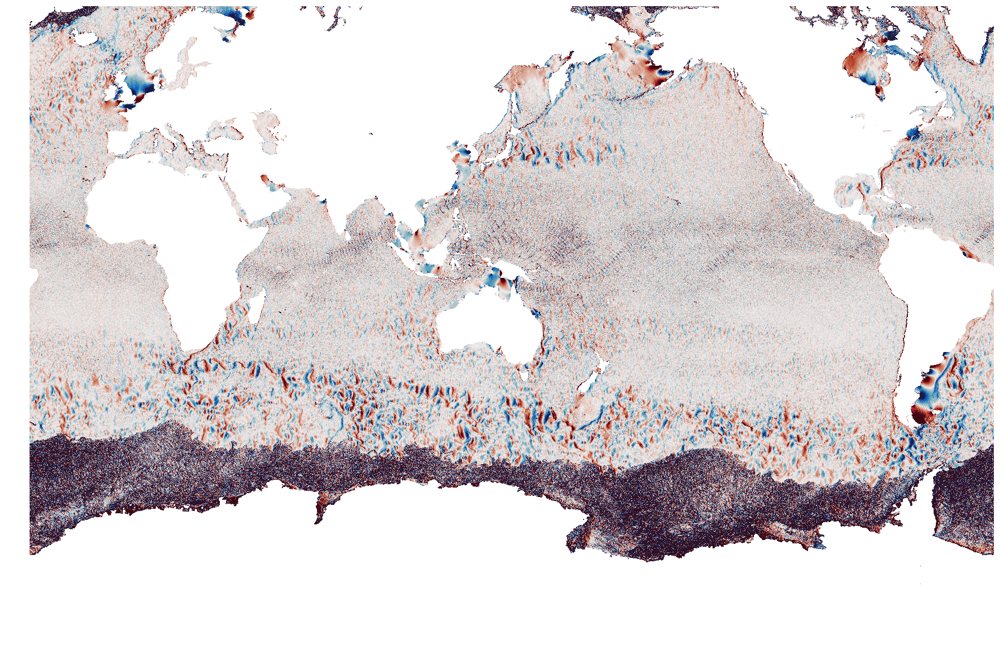

In [45]:
quick_llc_plot(ds['dB_dx'].isel(time=80), vmin=-0.0001, vmax=0.0001, add_colorbar=False, axis_off=True, cmap = cm.balance)

distributed.comm.tcp - WARNING - Closing dangling stream in <TCP local=tcp://10.148.1.24:33842 remote=tcp://10.148.1.24:55110>
distributed.comm.tcp - WARNING - Closing dangling stream in <TCP local=tcp://10.148.1.24:33843 remote=tcp://10.148.1.24:55110>


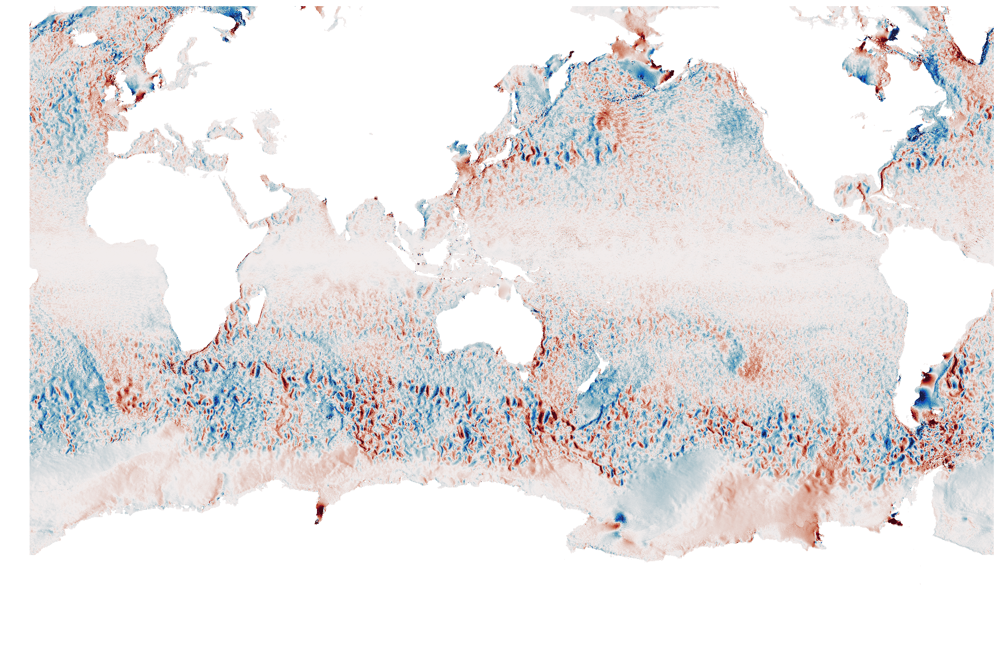

In [57]:
quick_llc_plot(ds['Coriolis_u'].isel(time=80), vmin=-0.0001, vmax=0.0001, add_colorbar=False, axis_off=True, cmap = cm.balance)

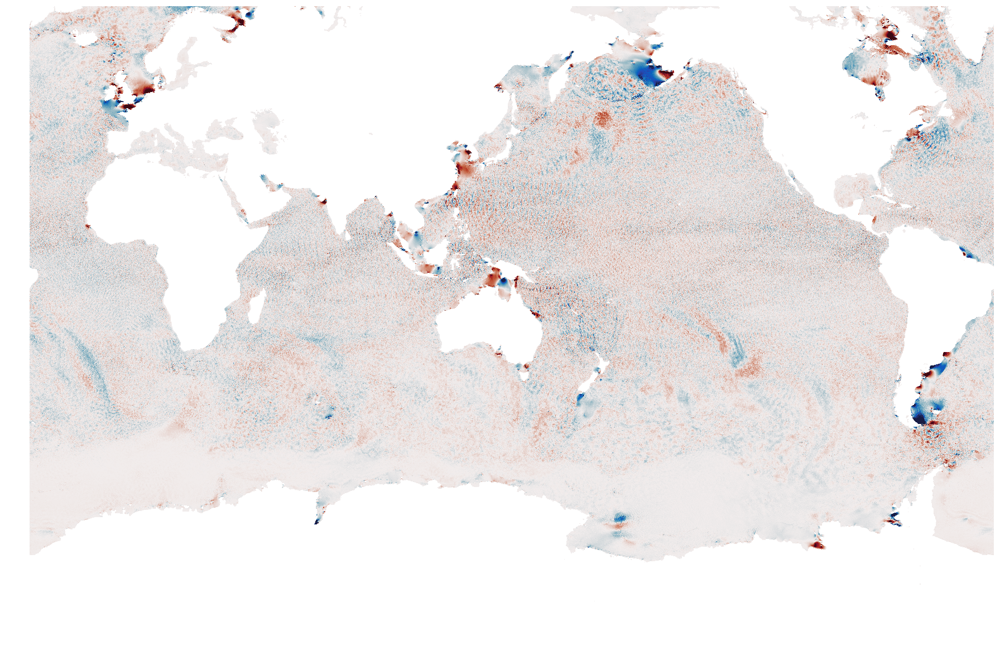

In [59]:
quick_llc_plot(ds['d_SSU_dt_time'].isel(time=80), vmin=-0.0001, vmax=0.0001, add_colorbar=False, axis_off=True, cmap = cm.balance)

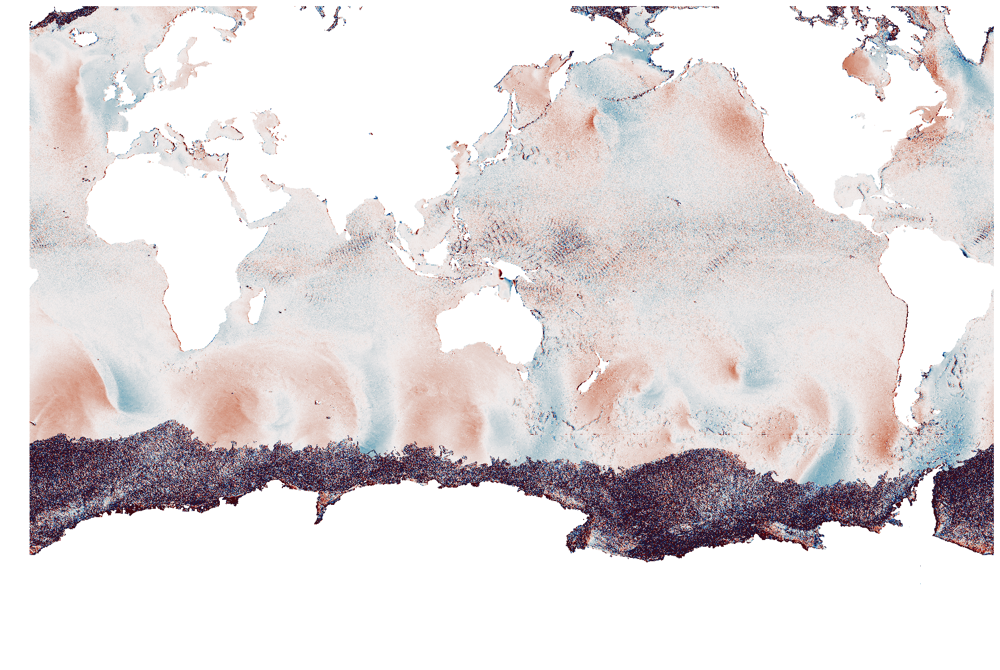

In [46]:
quick_llc_plot(ds['residuals_u'].isel(time=80), vmin=-0.0001, vmax=0.0001, add_colorbar=False, axis_off=True, cmap = cm.balance)

### meridional momentum

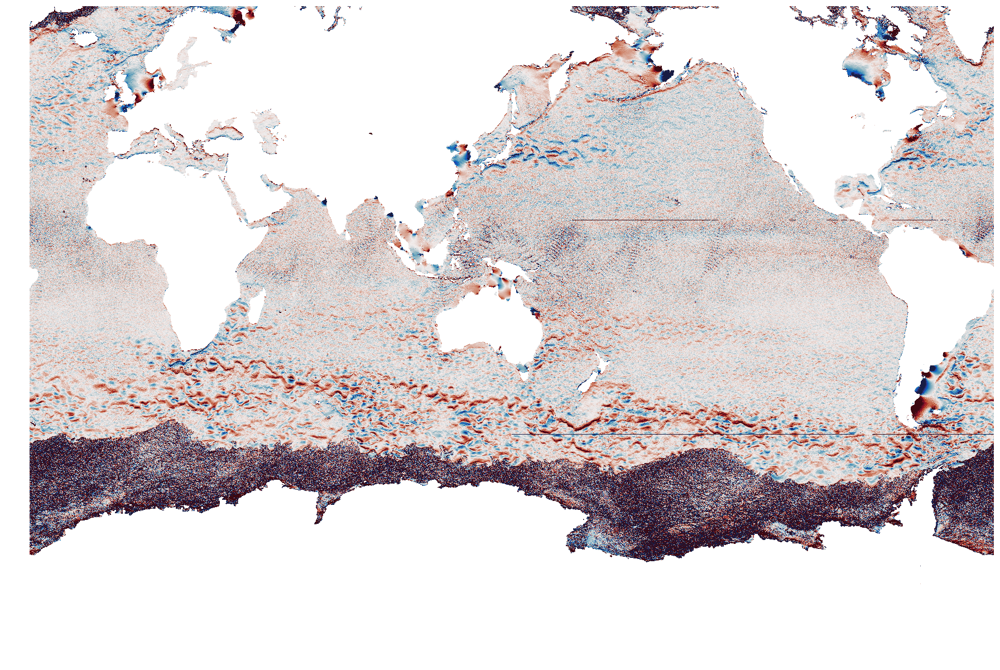

In [38]:
quick_llc_plot(ds['dB_dy'].isel(time=80), vmin=-0.0001, vmax=0.0001, add_colorbar=False, axis_off=True, cmap = cm.balance)

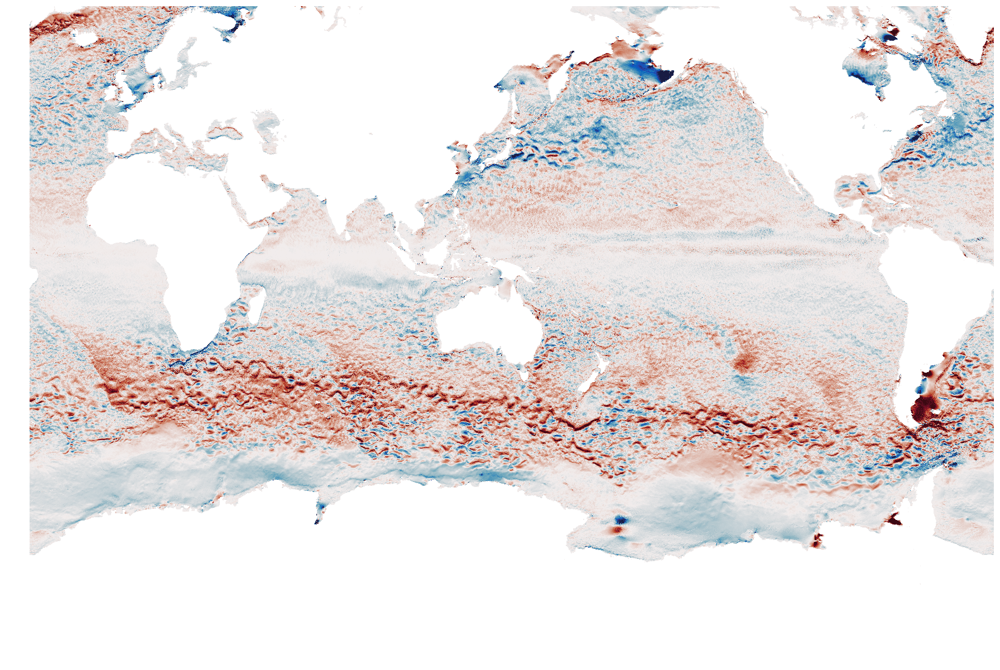

In [39]:
quick_llc_plot(ds['Coriolis_v'].isel(time=80), vmin=-0.0001, vmax=0.0001, add_colorbar=False, axis_off=True, cmap = cm.balance)

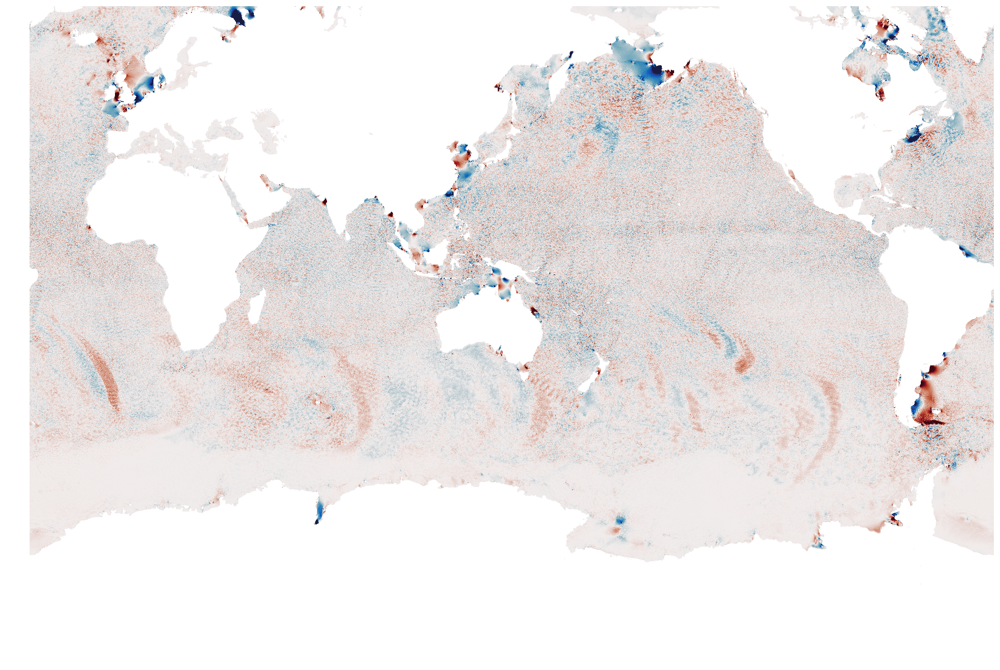

In [40]:
quick_llc_plot(ds['d_SSV_dt_time'].isel(time=80), vmin=-0.0001, vmax=0.0001, add_colorbar=False, axis_off=True, cmap = cm.balance)

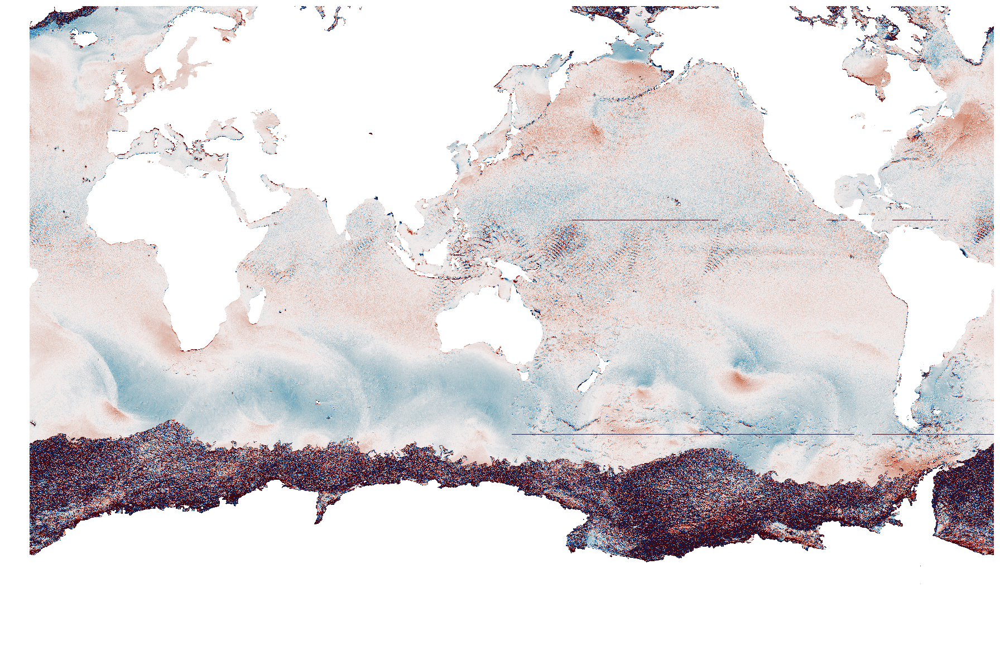

In [41]:
quick_llc_plot(ds['residuals_v'].isel(time=80), vmin=-0.0001, vmax=0.0001, add_colorbar=False, axis_off=True, cmap = cm.balance)

In [13]:
cluster.scheduler.close()

<Future finished result=None>